## <font color='blue'>Generating Realistic Human Faces with Generative Networks</font>

## Installing and Loading Packages

In [1]:
import os
# Python version
from platform import python_version
print('Python version is: ', python_version())

Python version is:  3.9.18


In [2]:
# Imports
import random
import numpy as np
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [3]:
#!pip install -q -U watermark

In [4]:
# Packages versions
%reload_ext watermark
%watermark -a "Cezar Mendes" --iversions

Author: Cezar Mendes

matplotlib : 3.8.3
torchvision: 0.15.2
numpy      : 1.26.4
torch      : 2.0.1



## Global Parameters

In [5]:
# Seed
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)

In [6]:
# Data root directory
dataroot = 'data/celeba'

In [7]:
# Number of works
workers = 4

In [8]:
# Number of GPUs
ngpu = 0

## Preparing the Image Folder and Dataloader

In [9]:
# Image Size
image_size = 64

In [10]:
# Create the dataset with the images folder
dataset = dset.ImageFolder(root = dataroot,
                           transform = transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [11]:
# Batch size for training
batch_size = 128

In [12]:
# Dataloader
dataloader = torch.utils.data.DataLoader(dataset, 
                                         batch_size = batch_size,
                                         shuffle = True, 
                                         num_workers = workers)

In [13]:
# Device
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(device)

cpu


## Viewing Training Images

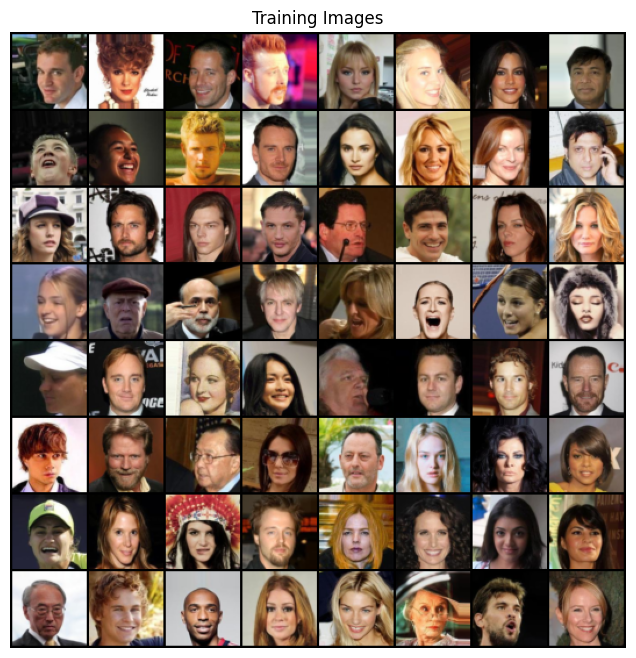

In [53]:
# Plot of some training images
real_batch = next(iter(dataloader))
plt.figure(figsize = (8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64],
                                          padding = 2,
                                          normalize = True).cpu(),(1,2,0)))
#plt.savefig("Training_images.png")
plt.show()

## Building Deep Convolutional Generative Adversarial Networks (DCGANs) Architecture

In [15]:
# Customized initialization of weights in dsanetG and dsanetD networks
def init_weights(m):
    
     classname = m.__class__.__name__
    
     if classname.find('Conv') != -1:
         nn.init.normal_(m.weight.data, 0.0, 0.02)
    
     elif classname.find('BatchNorm') != -1:
         nn.init.normal_(m.weight.data, 1.0, 0.02)
         nn.init.constant_(m.bias.data, 0)

In [16]:
# Number of color channels in training images
nc = 3

In [17]:
# Size of latent vector z (i.e. size of generator input)
nz = 100

In [18]:
# Size of feature maps in the generator
ngf = 64

In [19]:
# Size of feature maps in the discriminator
ndf = 64

## Building the Generator

In [21]:
# Generator class
class Generator(nn.Module):
    
     # Builder Method
     def __init__(self, ngpu):
        
         super(Generator, self).__init__()
        
         self.ngpu = ngpu
        
         self.main = nn.Sequential(
            
             #Input
             nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias = False),
             nn.BatchNorm2d(ngf * 8),
             nn.ReLU(True),
            
             # Size: (ngf*8) x 4 x 4
             nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias = False),
             nn.BatchNorm2d(ngf * 4),
             nn.ReLU(True),
            
             # Size: (ngf*4) x 8 x 8
             nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias = False),
             nn.BatchNorm2d(ngf * 2),
             nn.ReLU(True),
            
             # Size: (ngf*2) x 16 x 16
             nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias = False),
             nn.BatchNorm2d(ngf),
             nn.ReLU(True),
            
             # Size: (ngf) x 32 x 32
             nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias = False),
             nn.Tanh()
         )

     # Forward Method
     def forward(self, input):
         return self.main(input)

In [22]:
# Create the generator
dsanetG = Generator(ngpu).to(device)

In [23]:
# Initialize the weights
dsanetG.apply(init_weights)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [24]:
# Model
print(dsanetG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Building the Discriminator

In [25]:
# Discriminator Class
class Discriminator(nn.Module):
    
     # Builder Method
     def __init__(self, ngpu):
        
         super(Discriminator, self).__init__()
        
         self.ngpu = ngpu
        
         self.main = nn.Sequential(
            
             # Input is (nc) x 64 x 64
             nn.Conv2d(nc, ndf, 4, 2, 1, bias = False),
             nn.LeakyReLU(0.2, inplace = True),
            
             # Size: (ndf) x 32 x 32
             nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias = False),
             nn.BatchNorm2d(ndf * 2),
             nn.LeakyReLU(0.2, inplace = True),
            
             # Size: (ndf*2) x 16 x 16
             nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias = False),
             nn.BatchNorm2d(ndf * 4),
             nn.LeakyReLU(0.2, inplace = True),
            
             # Size: (ndf*4) x 8 x 8
             nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias = False),
             nn.BatchNorm2d(ndf * 8),
             nn.LeakyReLU(0.2, inplace = True),
            
             # Size: (ndf*8) x 4 x 4
             nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias = False),
             nn.Sigmoid()
         )

     # Forward Method
     def forward(self, input):
         return self.main(input)

In [26]:
# Create the discriminator
dsanetD = Discriminator(ngpu).to(device)

In [27]:
# Initialize the weights
dsanetD.apply(init_weights)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [28]:
# Model
print(dsanetD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Function and Optimizer

In [29]:
# Initialize the BCELoss error function
criterion = nn.BCELoss()

In [30]:
# Learning rate
lr = 0.0002

In [31]:
# Adam optimizer hyperparameters
beta1 = 0.5
beta2 = 0.999

In [32]:
# Adam optimizer for both G and D networks
optimizerD = optim.Adam(dsanetD.parameters(), lr = lr, betas = (beta1, beta2))
optimizerG = optim.Adam(dsanetG.parameters(), lr = lr, betas = (beta1, beta2))

## Training and Assessment Loop

In [33]:
# Number of epochs
num_epochs = 5

In [34]:
# Establish conventions for real and fake labels during training
real_label = 1.
fake_label = 0.

In [35]:
# Creates a batch of latent vectors that we will use to visualize the generator progression (for model evaluation)
fixed_noise = torch.randn(64, nz, 1, 1, device = device)

In [36]:
type(fixed_noise)

torch.Tensor

In [37]:
fixed_noise.size()

torch.Size([64, 100, 1, 1])

In [38]:
fixed_noise

tensor([[[[-3.3584e-01]],

         [[ 8.5575e-05]],

         [[-1.4638e+00]],

         ...,

         [[ 1.1122e+00]],

         [[ 8.3746e-01]],

         [[-1.4736e+00]]],


        [[[-1.9611e+00]],

         [[ 3.3999e-01]],

         [[ 4.9899e-01]],

         ...,

         [[-3.8476e-01]],

         [[ 8.5773e-01]],

         [[ 9.2803e-03]]],


        [[[-4.0077e-02]],

         [[ 5.9576e-01]],

         [[-1.2126e+00]],

         ...,

         [[ 9.3761e-01]],

         [[-7.5064e-01]],

         [[ 2.0074e-01]]],


        ...,


        [[[ 2.6855e-02]],

         [[-1.8387e+00]],

         [[ 3.5533e-02]],

         ...,

         [[ 1.9720e-01]],

         [[-2.6004e-01]],

         [[ 1.3871e+00]]],


        [[[-2.9840e-01]],

         [[-6.0307e-01]],

         [[-1.1872e+00]],

         ...,

         [[ 3.3006e-01]],

         [[ 1.5199e+00]],

         [[ 1.1145e+00]]],


        [[[ 2.3434e-01]],

         [[ 8.0483e-01]],

         [[-1.8956e-02]],

         

In [39]:
# Lists to track progress
img_list = []
G_losses = []
D_losses = []
iters = 0

In [41]:
%%time
print("Starting Training...")

# Loop for each epoch
for epoch in range(num_epochs):
    
     # Loop for each dataloader batch
     for i, data in enumerate(dataloader, 0):

         ###########################
         # (1) Update network D by maximizing: log(D(x)) + log(1 - D(G(z)))
         ##########################
        
         # Reset the gradients
         dsanetD.zero_grad()
        
         # Prepare the batch of data
         real_cpu = data[0].to(device)
         b_size = real_cpu.size(0)
         label = torch.full((b_size,), real_label, dtype = torch.float, device = device)
        
         # Forward pass of real data over D network
         output = dsanetD(real_cpu).view(-1)
        
         # Calculate the error
         errD_real = criterion(output, label)
        
         # Calculate the gradients of the D network in the backward pass for the real data
         errD_real.backward()
         D_x = output.mean().item()

         # Generate the latent vector
         noise = torch.randn(b_size, nz, 1, 1, device = device)
        
         # Generate fake images with the G network
         fake = dsanetG(noise)
         label.fill_(fake_label)
        
         # Classify fake images with the D network
         output = dsanetD(fake.detach()).view(-1)
        
         # Calculate the D error with fake images
         errD_fake = criterion(output, label)
        
         # Calculate the gradients for each batch in the fake data
         errD_fake.backward()
         D_G_z1 = output.mean().item()
        
         # The error of network D is the sum of errors with real data and fake data
         errD = errD_real + errD_fake
        
         # Update the weights of the D network
         optimizerD.step()

         ###########################
         # (2) Update the network G by maximizing: log(D(G(z)))
         ##########################
        
         # Reset the gradients
         dsanetG.zero_grad()
        
         # Fake labels are filled with real labels
         label.fill_(real_label)
        
         # after update the D, needs run another batch pass of fake images through D
         output = dsanetD(fake).view(-1)
        
         # Calculate the loss of G based on this previous output
         errG = criterion(output, label)
        
         # Calculate the gradients of G
         errG.backward()
         D_G_z2 = output.mean().item()
        
         # Update the weights in G
         optimizerG.step()

         # Training statistics
         if i % 50 == 0:
             print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f'
                   % (epoch, num_epochs, i, len(dataloader),
                      errD.item(), errG.item()))

         # Save errors to create a plot later
         G_losses.append(errG.item())
         D_losses.append(errD.item())

         # Checking how the generator is saving the output of G in fixed_noise
         if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
             with torch.no_grad():
                 fake = dsanetG(fixed_noise).detach().cpu()
                
             img_list.append(vutils.make_grid(fake, padding = 2, normalize = True))

         iters += 1
        
print("Training Completed!")

Starting Training...
[0/5][0/1583] Loss_D: 1.7227 Loss_G: 5.2589
[0/5][50/1583] Loss_D: 0.3556 Loss_G: 30.5602
[0/5][100/1583] Loss_D: 0.3822 Loss_G: 11.0091
[0/5][150/1583] Loss_D: 0.5240 Loss_G: 5.7152
[0/5][200/1583] Loss_D: 0.4553 Loss_G: 4.6721
[0/5][250/1583] Loss_D: 0.6295 Loss_G: 6.6468
[0/5][300/1583] Loss_D: 0.2457 Loss_G: 4.3313
[0/5][350/1583] Loss_D: 1.4805 Loss_G: 8.5652
[0/5][400/1583] Loss_D: 0.8096 Loss_G: 3.8812
[0/5][450/1583] Loss_D: 0.6176 Loss_G: 7.1896
[0/5][500/1583] Loss_D: 0.4478 Loss_G: 5.1980
[0/5][550/1583] Loss_D: 1.0934 Loss_G: 3.4527
[0/5][600/1583] Loss_D: 0.3560 Loss_G: 4.5786
[0/5][650/1583] Loss_D: 0.7292 Loss_G: 5.7664
[0/5][700/1583] Loss_D: 0.6129 Loss_G: 5.8550
[0/5][750/1583] Loss_D: 0.3163 Loss_G: 5.2341
[0/5][800/1583] Loss_D: 1.4123 Loss_G: 9.9624
[0/5][850/1583] Loss_D: 0.5113 Loss_G: 4.3549
[0/5][900/1583] Loss_D: 0.3498 Loss_G: 5.7309
[0/5][950/1583] Loss_D: 0.6614 Loss_G: 3.2503
[0/5][1000/1583] Loss_D: 0.4761 Loss_G: 4.6619
[0/5][1050/15

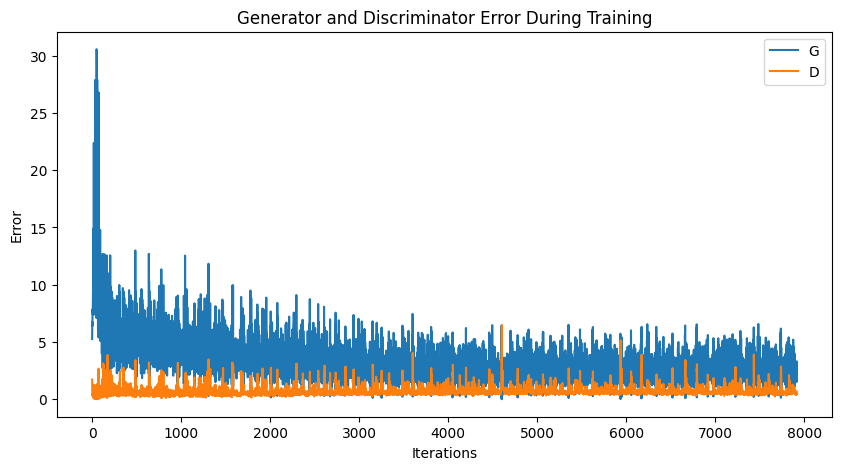

In [52]:
# Plot
plt.figure(figsize = (10,5))
plt.title("Generator and Discriminator Error During Training")
plt.plot(G_losses,label = "G")
plt.plot(D_losses,label = "D")
plt.xlabel("Iterations")
plt.ylabel("Error")
plt.legend()
#plt.savefig("Generator and Discriminator Error During Training.png")
plt.show()


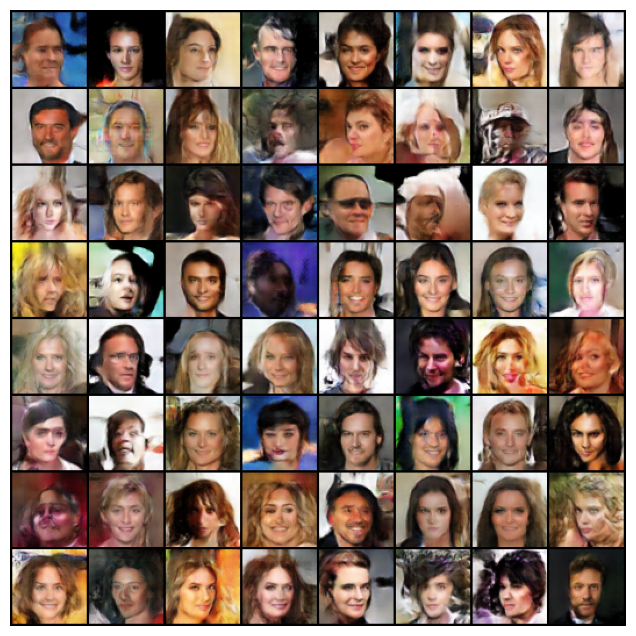

In [43]:
# Animation
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated = True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval = 1000, repeat_delay = 1000, blit = True)
HTML(ani.to_jshtml())

In [48]:
#ani.save(filename="amimation_dcgans.gif", writer="pillow")

In [44]:
# Get a batch of real images from the dataloader
real_batch = next(iter(dataloader))

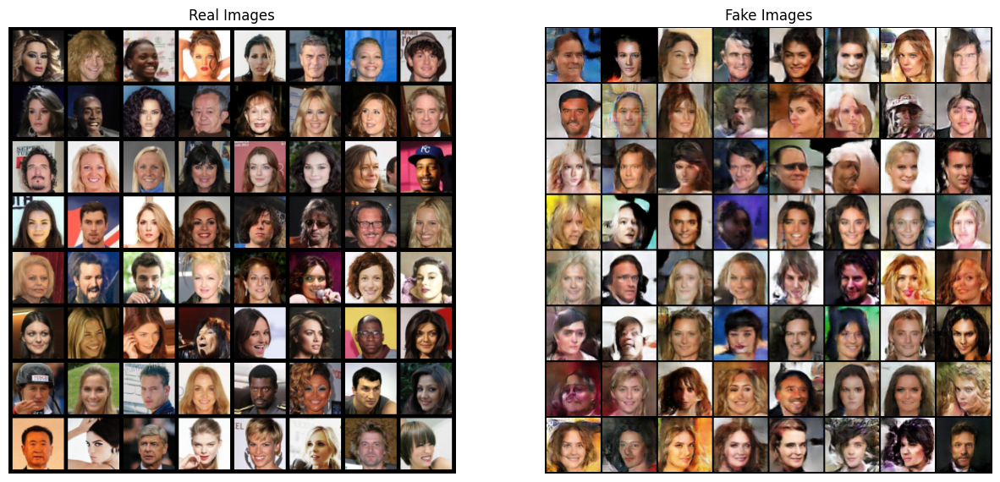

In [51]:
# Plot of real images
plt.figure(figsize = (15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64],
                                          padding = 5,
                                          normalize = True).cpu(),(1,2,0)))

# Plot of fake images from the last training season
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
#plt.savefig("RealxFake_Images.png")
plt.show()